In [2]:
#Collin Reinking
#collin.reinking@berkeley.edu

import folium #<--the real star

%matplotlib inline
import pandas as pd
import re
import os
from folium.plugins import FloatImage
# from notebook import notebookapp
# servers = list(notebookapp.list_running_servers())
# pwd = !pwd
# for s in servers:
#     if s['notebook_dir'] == pwd[0]:
#         server_url = s['url']
#         break  

# Simple Dot Plot On Map

In [3]:
data = pd.read_pickle('data/listings_cleaned.pkl')
data = pd.DataFrame(data, columns = ['latitude','longitude']) #[:50]  <-this kind of slice is useful for developing a map
data.head()

,latitude,longitude
listing_id,,
5794291,45.533373,-122.648236
15358320,45.532048,-122.641223
15164536,45.533932,-122.647206
6106997,45.534491,-122.646883
5134256,45.533274,-122.646870


In [8]:
#create a map
this_map = folium.Map(prefer_canvas=True)

def plotDot(point):
    '''input: series that contains a numeric named latitude and a numeric named longitude
    this function creates a CircleMarker and adds it to your this_map'''
    folium.CircleMarker(location=[point.latitude, point.longitude],
                        radius=2,
                        weight=0).add_to(this_map)

#use df.apply(,axis=1) to iterate through every row in your dataframe
data.apply(plotDot, axis = 1)


#Set the zoom to the maximum possible
this_map.fit_bounds(this_map.get_bounds())

#Save the map to an HTML file
#this_map.save(os.path.join('html_map_output/simple_dot_plot.html'))

this_map

# Clickable dots with Popup Info

In [9]:
data = pd.read_pickle('data/listings_cleaned.pkl')
data = pd.DataFrame(data, columns = ['latitude','longitude','listing_name']) #[:50]  <-this kind of slice is useful for developing a mapdata.head()

In [10]:
#create a map
this_map = folium.Map(prefer_canvas=True)

def plotDot(point):
    '''input: series that contains a numeric named latitude and a numeric named longitude
    this function creates a CircleMarker and adds it to your this_map'''
    folium.CircleMarker(location=[point.latitude, point.longitude],
                        radius=2,
                        weight=0,#remove outline
                        popup = point.listing_name,
                        fill_color='#000000').add_to(this_map)

#use df.apply(,axis=1) to iterate through every row in your dataframe
data.apply(plotDot, axis = 1)


#Set the zoom to the maximum possible
this_map.fit_bounds(this_map.get_bounds())

#Save the map to an HTML file
#this_map.save(os.path.join('html_map_output/basic_pop_up.html'))

this_map

# Clickable dots with Clickable Popup Info

In [3]:
data = pd.read_pickle('data/listings_cleaned.pkl')
data = pd.DataFrame(data, columns = ['latitude','longitude','listing_name','listing_url','host_name','host_url'])
data.head()

,latitude,longitude,listing_name,listing_url,host_name,host_url
listing_id,,,,,,
5794291,45.533373,-122.648236,Private suites near it all- Room #6,https://www.airbnb.com/rooms/5794291,Phil,https://www.airbnb.com/users/show/3029738
15358320,45.532048,-122.641223,Bohemian Escape,https://www.airbnb.com/rooms/15358320,Pamela,https://www.airbnb.com/users/show/78494301
15164536,45.533932,-122.647206,NE BUNK-HOUSE : Single bed - TOP,https://www.airbnb.com/rooms/15164536,Ian & Sharmil,https://www.airbnb.com/users/show/17261537
6106997,45.534491,-122.646883,"LOCATION NE! ""Mt Hood"" : King bed",https://www.airbnb.com/rooms/6106997,Ian & Sharmil,https://www.airbnb.com/users/show/17261537
5134256,45.533274,-122.646870,Private suites near it all- Room #4,https://www.airbnb.com/rooms/5134256,Phil,https://www.airbnb.com/users/show/3029738


In [15]:
import re

#create a map
this_map = folium.Map(prefer_canvas=True)

def popopHTMLString(point):
    '''input: a series that contains a url somewhere in it and generate html'''
    html = 'Listing: '
    html += '<a href="'
    html += point.listing_url
    html += '"target="_blank">'
    html += re.sub(r"[']+", "\\\\'", point.listing_name)[:45]  #to put a \ in front of any ' in the name
    html += ' </a>'
    
    html += ' <br>'
    html += 'Host: '
    html += '<a href="'
    html += point.host_url
    html += '"target="_blank">'
    html += re.sub(r"[']+", "\\\\'", point.host_name)
    html += ' </a>'
    
    return html

def plotDot(point):
    '''input: series that contains a numeric named latitude and a numeric named longitude
    this function creates a CircleMarker and adds it to your this_map'''
    htmlString = folium.Html(popopHTMLString(point), script=True)
    folium.CircleMarker(location=[point.latitude, point.longitude],
                        radius=2,
                        weight=0,#remove outline
                        popup = folium.Popup(htmlString),
                        fill_color='#000000').add_to(this_map)

    
    
#use df.apply(,axis=1) to iterate through every row in your dataframe
data.apply(plotDot, axis = 1)


#Set the zoom to the maximum possible
this_map.fit_bounds(this_map.get_bounds())

#Save the map to an HTML file
#this_map.save(os.path.join('html_map_output/html_pop_up.html'))


this_map

# Color by value using a Colormap

In [2]:
data = pd.read_pickle('data/listings_cleaned.pkl')
data = pd.DataFrame(data, columns = ['latitude','longitude','listed_price','accommodates'])
data['price_per_person'] = data.listed_price / data.accommodates
data.drop(['listed_price','accommodates'], axis='columns', inplace=True)
data.head()

,latitude,longitude,price_per_person
listing_id,,,
5794291,45.533373,-122.648236,50.000000
15358320,45.532048,-122.641223,32.500000
15164536,45.533932,-122.647206,42.000000
6106997,45.534491,-122.646883,21.666667
5134256,45.533274,-122.646870,35.000000


In [25]:
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib import colors
from scipy import stats

#create a map
this_map = folium.Map(prefer_canvas=True)

#create a color map
my_colors = [(0, 0, 1), (1, 0, 0)] #the first color is blue, the last color is red (in rgb)
cm = colors.LinearSegmentedColormap.from_list("MyMap", my_colors, N=1000) #cm is the color map
color_var = 'price_per_person' #what variable will determine the color
norm = colors.Normalize(vmin=data[color_var].quantile(0.05), vmax=data[color_var].quantile(0.95))
#I had some outlying data so I use the 5th and 95th percentile instead of the min and max
#like you see in next line
#norm = colors.Normalize(vmin=data[color_var].min(), vmax=data[color_var].max())


def plotDot(point):
    '''input: series that contains a numeric named latitude and a numeric named longitude
    this function creates a CircleMarker and adds it to your this_map'''
    folium.CircleMarker(location=[point.latitude, point.longitude],
                        fill_color=colors.to_hex(cm(norm(point[color_var]))),
                        radius=2,
                        weight=0).add_to(this_map)

#use df.apply(,axis=1) to iterate through every row in your dataframe
data.apply(plotDot, axis = 1)


#Set the zoom to the maximum possible
this_map.fit_bounds(this_map.get_bounds())

#Save the map to an HTML file
#this_map.save(os.path.join('html_map_output/color_by_value.html'))


this_map

## Adding a legend to colored dot plot

In [9]:
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib import colors
from scipy import stats
from folium.plugins import FloatImage

#create a map
this_map = folium.Map(prefer_canvas=True)

#create a color map
my_colors = [(0, 0, 1), (1, 0, 0)] #the first color is blue, the last color is red (in rgb)
cm = colors.LinearSegmentedColormap.from_list("MyMap", my_colors, N=1000) #cm is the color map
color_var = 'price_per_person' #what variable will determine the color
norm = colors.Normalize(vmin=data[color_var].quantile(0.05), vmax=data[color_var].quantile(0.95))

#####################
##  Create Legend  ##
#####################

fig = plt.figure(figsize=(4, .1))
ax = fig.add_axes([1, 1, 1, 1])

leg = mpl.colorbar.ColorbarBase(ax, cmap=cm,
                                norm=norm,
                                orientation='horizontal')
leg.set_ticks([norm.inverse(0),norm.inverse(1)])
leg.set_ticklabels([norm.inverse(0),norm.inverse(1)])

fig.text(1.5, 2, color_var,
        horizontalalignment='center',
        verticalalignment='bottom')


#
#

fig.savefig(str('html_map_output/legends/legend'+color_var+'.png'), bbox_inches='tight',transparent=True)
fig.savefig(str('legends/legend'+color_var+'.png'), bbox_inches='tight',transparent=True)

plt.close(fig)

#the top line will work great for displaying inside of jupyter notebooks
#the bootom line will work great for the html file that are generated
#FloatImage('str(server_url + 'files/'legends/legend'+color_var+'.png'),bottom=90, left=65).add_to(this_map)
FloatImage('legends/legend'+color_var+'.png',bottom=90, left=65).add_to(this_map)


#####################
##    The End      ##
#####################

def plotDot(point):
    '''input: series that contains a numeric named latitude and a numeric named longitude
    this function creates a CircleMarker and adds it to your this_map'''
    folium.CircleMarker(location=[point.latitude, point.longitude],
                        fill_color=colors.to_hex(cm(norm(point[color_var]))),
                        radius=2,
                        weight=0).add_to(this_map)

#use df.apply(,axis=1) to iterate through every row in your dataframe
data.apply(plotDot, axis = 1)


#Set the zoom to the maximum possible
this_map.fit_bounds(this_map.get_bounds())

#Save the map to an HTML file
this_map.save(os.path.join('html_map_output/color_by_value_with_legend.html'))

this_map

# Color Points by quartile groupings

In [29]:
data = pd.read_pickle('data/listings_cleaned.pkl')
data = pd.DataFrame(data, columns = ['latitude','longitude','listed_price','listing_name','listing_url','host_name','host_url'])
data.head()

,latitude,longitude,listed_price,listing_name,listing_url,host_name,host_url
listing_id,,,,,,,
5794291,45.533373,-122.648236,100.0,Private suites near it all- Room #6,https://www.airbnb.com/rooms/5794291,Phil,https://www.airbnb.com/users/show/3029738
15358320,45.532048,-122.641223,65.0,Bohemian Escape,https://www.airbnb.com/rooms/15358320,Pamela,https://www.airbnb.com/users/show/78494301
15164536,45.533932,-122.647206,42.0,NE BUNK-HOUSE : Single bed - TOP,https://www.airbnb.com/rooms/15164536,Ian & Sharmil,https://www.airbnb.com/users/show/17261537
6106997,45.534491,-122.646883,65.0,"LOCATION NE! ""Mt Hood"" : King bed",https://www.airbnb.com/rooms/6106997,Ian & Sharmil,https://www.airbnb.com/users/show/17261537
5134256,45.533274,-122.646870,70.0,Private suites near it all- Room #4,https://www.airbnb.com/rooms/5134256,Phil,https://www.airbnb.com/users/show/3029738


In [30]:
color_var = 'listed_price'
quartile = [data[color_var].quantile(q/4) for q in range(5)]
def quartile_of(n):
    for qn,q in enumerate(quartile):
        if n<=q: return max(1,qn)/4
data['color_group'] = data[color_var].apply(quartile_of)

In [31]:
#create a map
this_map = folium.Map(prefer_canvas=True)

#create a color map
my_colors = [(.4, .4, 1), (0, .9, 0) ,(1, .6, 0) , (1, 0, 0)] 
cm = colors.LinearSegmentedColormap.from_list("MyMap", my_colors, N=4) #cm is the color map
norm = colors.Normalize(0, 1)

color_dict = {data.ix[p][color_var]:colors.to_hex(cm(data.ix[p].color_group-.0001)) for p in data.T}

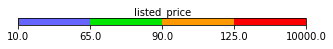

In [32]:
fig = plt.figure(figsize=(4, .1))
ax = fig.add_axes([1, 1, 1, 1])

leg = mpl.colorbar.ColorbarBase(ax, cmap=cm,
                                norm=norm,
                                orientation='horizontal')
leg.set_ticks([q/4 for q in range(5)])
leg.set_ticklabels([data[color_var].quantile(q/4) for q in range(5)])

fig.text(1.5, 2, color_var,
        horizontalalignment='center',
        verticalalignment='bottom')

fig.savefig(str('legends/legend_'+color_var+'_quartiles.png'), bbox_inches='tight',transparent=True)
#plt.close(fig)
#To DO:  there has to be a smarter way to do this (dealing with the "URL" issue)
FloatImage(str(server_url + 'files/legends/legend_'+color_var+'_quartiles.png'),bottom=90, left=65).add_to(this_map)



In [33]:
def popopHTMLString(point):
    '''input: a series that contains a url somewhere in it and generate html'''
    html = 'Listing: '
    html += '<a href="'
    html += point.listing_url
    html += '"target="_blank">'
    html += re.sub(r"[']+", "\\\\'", point.listing_name)  #to put a \ in front of any ' in the name
    html += ' </a>'

    html += ' <br>'
    html += 'Host: '
    html += '<a href="'
    html += point.host_url
    html += '"target="_blank">'
    html += re.sub(r"[']+", "\\\\'", point.host_name)
    html += ' </a>'
    
    html += ' <br>'
    html += 'listed_price = '
    html += str('${:,.2f}'.format(point.listed_price))
    
    return html


In [34]:
def plotDot(point):
    '''input: series that contains a numeric named latitude and a numeric named longitude
    this function creates a CircleMarker and adds it to your this_map'''
    htmlString = folium.Html(popopHTMLString(point), script=True)
    folium.CircleMarker(location=[point.latitude, point.longitude],
                        fill_color=color_dict[point[color_var]],   ####NOTE THE CHANGE IN THE COLOR
                        radius=2,
                        popup = folium.Popup(htmlString),
                        weight=0).add_to(this_map)

 
    
#use df.apply(,axis=1) to iterate through every row in your dataframe
data.apply(plotDot, axis = 1)


#Set the zoom to the maximum possible
this_map.fit_bounds(this_map.get_bounds())

#Save the map to an HTML file
#this_map.save(os.path.join('html_map_output/color_by_value_quartile.html'))

this_map

In [3]:
import matplotlib.pyplot as plt
x = [1,2,3,4]
y = [10,20,30,40]
Temp = [100,200,300,400]

plt.scatter(x,y,c=Temp)
plt.colorbar().show()

AttributeError: 'Colorbar' object has no attribute 'show'